### 문제1. 이미지 세그멘테이션 모델을 만들고, 전체 코드와 테스트 결과를 주피터 노트북 파일로 깃헙 제출

- 이미지 데이터를 적절히 전처리 한 후 데이터 파이프라인을 설계합니다.
- 모델은 U-NET으로 고정합니다. 올바른 훈련 진행을 위해 원본에서 변경이 필요할 수 있습니다.
- 케창딥에서 배운 모든 방법을 사용해 최고 기록을 달성해보세요.
- 데이터와 모델, Metric 결과 등을 상세하게 분석하면 추가 점수

---

### 문제2. 이미지 분할 학습 결과를 텐서보드로 시각화합니다.
텐서보드 결과를 README.md 파일에 올리기

---

### 데이터, 모델 분석내용 및 결과
1. 우선 데이터는 1920, 1080 사이즈로 되어있어서 resize가 필요했다. gpu메모리가 부족하여 사이즈가 너무 큰 경우에는 실행이 되지 않았다. 그리고 파일명에 따라서 원본 이미지와 세그멘테이션 이미지가 나눠져 있어서 구분해서 나눠준다.

2. 모델 U-NET은 다운샘플링하면서 채널을 늘리고 업샘플링마다 채널 수를 반으로 줄인다. 그래서 U자 모형으로 모델이 생겼다..

3. 결론은 이미지 사이즈도 중요했고 정확도는 드랍아웃을 적용했을 때랑 안했을 때가 비슷했지만 결과 이미지는 드랍아웃이 적용된 모델이 조금 구분이 잘 되는 느낌이 있었다. 예를 들면 하늘이 노란색으로 나오는 부분이 없다..!


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
from PIL import Image
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Rescaling, Conv2D, MaxPooling2D, UpSampling2D, concatenate, Dropout

In [ ]:
# 이미지 파일 경로
image_dir = '/content/drive/MyDrive/Colab Notebooks/Motorcycle Night Ride Dataset/images'


input_img_paths = sorted([os.path.join(image_dir, fname)
                          for fname in os.listdir(image_dir)
                          if not (('fuse' in fname) or ('save' in fname))])
target_img_paths = sorted([os.path.join(image_dir, fname)
                           for fname in os.listdir(image_dir)
                           if 'fuse' in fname])

# 입력 데이터 개수 확인
print(len(input_img_paths))

# 타겟 데이터 개수 확인
print(len(target_img_paths))

200
200


(1920, 1080)

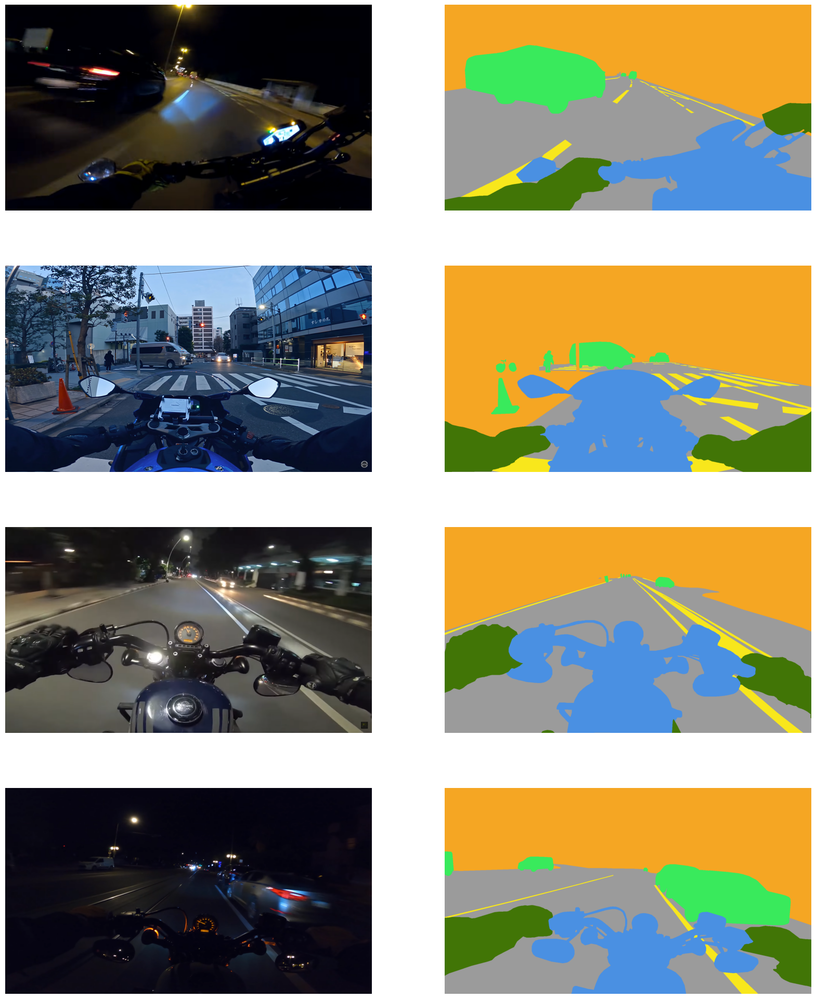

In [ ]:
# 데이터 직접 확인
import matplotlib.pyplot as plt
from tensorflow.keras.utils import load_img, img_to_array

plt.figure(figsize=(20,25))
for j in range(4):
    plt.subplot(4,2,2*j+1)
    plt.axis("off")
    plt.imshow(load_img(input_img_paths[j*50]))
    plt.subplot(4,2,2*j+2)
    plt.axis("off")
    plt.imshow(load_img(target_img_paths[j*50]))

# 타겟 데이터의 내부 값 확인
import numpy as np

target = load_img(target_img_paths[0], color_mode='grayscale')
target = img_to_array(target)
target = target.astype("uint8")
color = np.unique(target)
color

#6개의 영역이 서로 다른 정수로 표현되어있다. 이를 0~5의 정수로 바꿔준다.
dict_color_to_label = dict()
dict_label_to_color = dict()
for i in range(6):
    i = np.uint8(i)
    dict_color_to_label[color[i]] = i
    dict_label_to_color[i] = color[i]

type(dict_color_to_label[89])

# 이미지 크기 확인
img = load_img(input_img_paths[0])
img.size

In [ ]:
import random

img_size = (272, 480) # 리스케일링 비율은 원본과 최대한 가깝게 유지하되, UNet 모델에서 MaxPooling을 4번 적용 가능한 정수 비율을 적용
num_imgs = len(input_img_paths)

# 데이터 셔플 및 전처리
random.Random(50).shuffle(input_img_paths)
random.Random(50).shuffle(target_img_paths)

def path_to_input_image(path):
    return img_to_array(load_img(path, target_size=img_size))

def path_to_target(path):
    img = img_to_array(load_img(path, target_size=img_size, color_mode="grayscale"))
    img = img.astype("uint8")
    for val in color:
        img = np.where(img==val, dict_color_to_label[val], img)
    return img

input_imgs = np.zeros((num_imgs,) + img_size + (3,), dtype="float32")
targets = np.zeros((num_imgs,) + img_size + (1,), dtype="uint8")

for i in range(num_imgs):
    input_imgs[i] = path_to_input_image(input_img_paths[i])
    targets[i] = path_to_target(target_img_paths[i])


In [ ]:
# 학습, 검증, 테스트 데이터 분할
num_test_samples = 20
num_val_samples = 20
train_input_imgs = input_imgs[:-(num_test_samples + num_val_samples)]
train_targets = targets[:-(num_test_samples + num_val_samples)]
val_input_imgs = input_imgs[-(num_test_samples + num_val_samples):-num_test_samples]
val_targets = targets[-(num_test_samples + num_val_samples):-num_test_samples]
test_input_imgs = input_imgs[-num_test_samples:]
test_targets = targets[-num_test_samples:]


In [ ]:
### 모델 정의 및 학습

# 모델 정의

def get_model(img_size, num_classes):

    inputs = Input(shape=img_size + (3,))
    rs = Rescaling(1./255)(inputs)

    c1 = Conv2D(64, (3, 3), activation='relu', padding='same')(rs)
    c1 = Conv2D(64, (3, 3), activation='relu', padding='same')(c1)
    p1 = MaxPooling2D((2, 2))(c1)

    c2 = Conv2D(128, (3, 3), activation='relu', padding='same')(p1)
    c2 = Conv2D(128, (3, 3), activation='relu', padding='same')(c2)
    p2 = MaxPooling2D((2, 2))(c2)

    c3 = Conv2D(256, (3, 3), activation='relu', padding='same')(p2)
    c3 = Conv2D(256, (3, 3), activation='relu', padding='same')(c3)
    p3 = MaxPooling2D((2, 2))(c3)

    c4 = Conv2D(512, (3, 3), activation='relu', padding='same')(p3)
    c4 = Conv2D(512, (3, 3), activation='relu', padding='same')(c4)
    p4 = MaxPooling2D((2, 2))(c4)

    c5 = Conv2D(1024, (3, 3), activation='relu', padding='same')(p4)
    c5 = Conv2D(1024, (3, 3), activation='relu', padding='same')(c5)

    u6 = UpSampling2D((2, 2))(c5)
    u6 = concatenate([u6, c4])
    c6 = Conv2D(512, (3, 3), activation='relu', padding='same')(u6)
    c6 = Conv2D(512, (3, 3), activation='relu', padding='same')(c6)

    u7 = UpSampling2D((2, 2))(c6)
    u7 = concatenate([u7, c3])
    c7 = Conv2D(256, (3, 3), activation='relu', padding='same')(u7)
    c7 = Conv2D(256, (3, 3), activation='relu', padding='same')(c7)

    u8 = UpSampling2D((2, 2))(c7)
    u8 = concatenate([u8, c2])
    c8 = Conv2D(128, (3, 3), activation='relu', padding='same')(u8)
    c8 = Conv2D(128, (3, 3), activation='relu', padding='same')(c8)

    u9 = UpSampling2D((2, 2))(c8)
    u9 = concatenate([u9, c1])
    c9 = Conv2D(64, (3, 3), activation='relu', padding='same')(u9)
    c9 = Conv2D(64, (3, 3), activation='relu', padding='same')(c9)

    outputs = Conv2D(num_classes, 3, activation='softmax', padding='same')(c9)

    model = Model(inputs=inputs, outputs=outputs)

    return model

model = get_model(img_size=img_size, num_classes=6)
model.summary()

from tensorflow.keras.callbacks import TensorBoard, ModelCheckpoint, EarlyStopping

model.compile(optimizer="adam", loss="sparse_categorical_crossentropy", metrics=["accuracy"])
callbacks = [TensorBoard(log_dir='./log'), ModelCheckpoint("segmentation.h5", save_best_only=True), EarlyStopping(monitor='val_loss', patience=8, restore_best_weights=True)]
history = model.fit(train_input_imgs, train_targets,
                    epochs=100,
                    callbacks=callbacks,
                    batch_size=16,
                    validation_data=(val_input_imgs, val_targets))


Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 272, 480, 3)]        0         []                            
                                                                                                  
 rescaling (Rescaling)       (None, 272, 480, 3)          0         ['input_1[0][0]']             
                                                                                                  
 conv2d (Conv2D)             (None, 272, 480, 64)         1792      ['rescaling[0][0]']           
                                                                                                  
 conv2d_1 (Conv2D)           (None, 272, 480, 64)         36928     ['conv2d[0][0]']              
                                                                                              

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


10/10 [==============================] - 39s 1s/step - loss: 25.0836 - accuracy: 0.2981 - val_loss: 1.6492 - val_accuracy: 0.2700
Epoch 2/100
10/10 [==============================] - 6s 644ms/step - loss: 1.5279 - accuracy: 0.4044 - val_loss: 1.4242 - val_accuracy: 0.4481
Epoch 3/100
10/10 [==============================] - 6s 645ms/step - loss: 1.4440 - accuracy: 0.4228 - val_loss: 1.3960 - val_accuracy: 0.4481
Epoch 4/100
10/10 [==============================] - 10s 1s/step - loss: 1.4102 - accuracy: 0.4228 - val_loss: 1.3511 - val_accuracy: 0.4487
Epoch 5/100
10/10 [==============================] - 9s 911ms/step - loss: 1.3654 - accuracy: 0.4360 - val_loss: 1.2928 - val_accuracy: 0.4624
Epoch 6/100
10/10 [==============================] - 8s 809ms/step - loss: 1.2906 - accuracy: 0.4757 - val_loss: 1.2272 - val_accuracy: 0.5284
Epoch 7/100
10/10 [==============================] - 5s 499ms/step - loss: 1.2229 - accuracy: 0.5098 - val_loss: 1.2303 - val_accuracy: 0.5385
Epoch 8/100
10

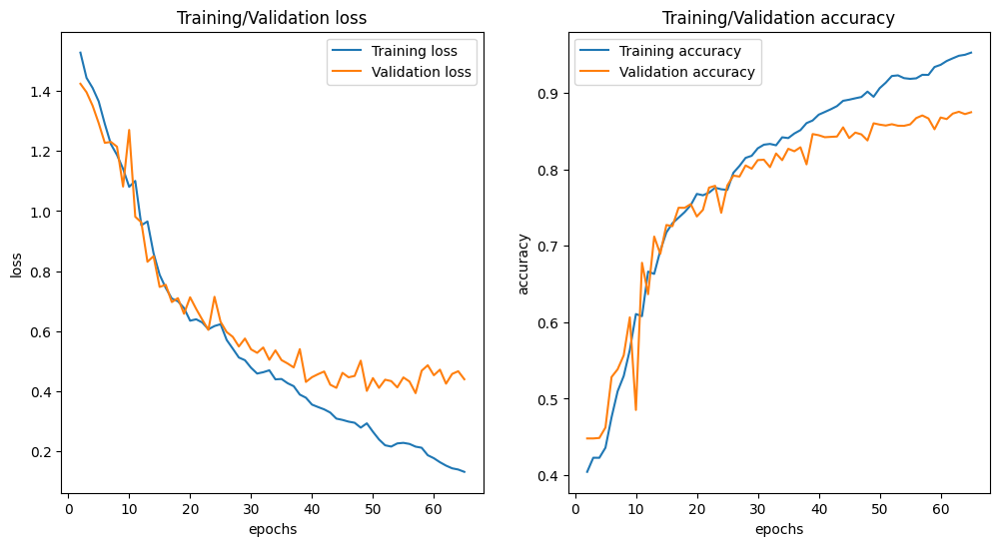

In [ ]:
# 결과 시각화

epochs = range(1, len(history.history["loss"]) + 1)[1:]
loss = history.history["loss"][1:]
val_loss = history.history["val_loss"][1:]
acc = history.history["accuracy"][1:]
val_acc = history.history["val_accuracy"][1:]

plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.plot(epochs, loss, label="Training loss")
plt.plot(epochs, val_loss, label="Validation loss")
plt.xlabel("epochs")
plt.ylabel("loss")
plt.title("Training/Validation loss")
plt.legend()

plt.subplot(1,2,2)
plt.plot(epochs, acc, label="Training accuracy")
plt.plot(epochs, val_acc, label="Validation accuracy")
plt.xlabel("epochs")
plt.ylabel("accuracy")
plt.title("Training/Validation accuracy")
plt.legend()

In [ ]:
from tensorflow.keras.models import load_model

model_path = 'segmentation.h5'

loaded_model = load_model(model_path)
loaded_model.evaluate(test_input_imgs, test_targets)

1/1 [==============================] - 10s 10s/step - loss: 0.3658 - accuracy: 0.8843


[0.36577245593070984, 0.884301483631134]

In [ ]:
prediction = loaded_model.predict(test_input_imgs)

1/1 [==============================] - 0s 236ms/step


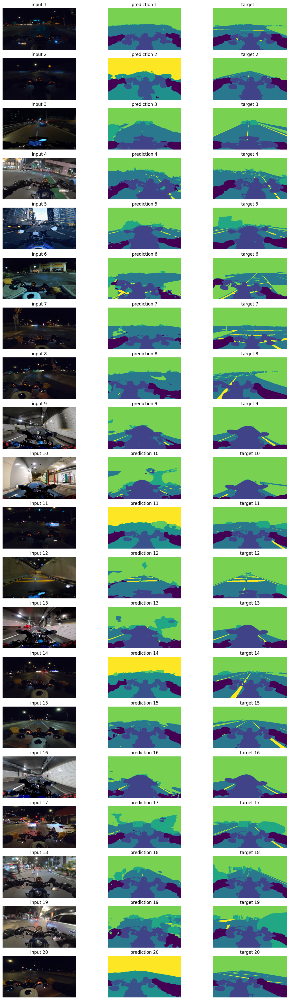

In [ ]:
# 모델의 예측 결과 시각화

def convert_output(pred):
    out = np.argmax(pred, axis=-1)
    return out

plt.figure(figsize=(15,50))

for i in range(20):
    plt.subplot(20,3,3*i+1)
    plt.axis('off')
    plt.imshow(test_input_imgs[i]/255)
    plt.title(f'input {i+1}')

    plt.subplot(20,3,3*i+2)
    plt.axis('off')
    output = prediction[i]
    output_img = convert_output(output)
    plt.imshow(output_img)
    plt.title(f'prediction {i+1}')

    plt.subplot(20,3,3*i+3)
    plt.axis('off')
    plt.imshow(test_targets[i])
    plt.title(f'target {i+1}')

In [ ]:
#!pip install tensorboard
#!pip install pyngrok

In [ ]:
%load_ext tensorboard

%tensorboard --logdir './log'
# %tensorboard dev upload \
#   --logdir './log' \
#   --name "MainQ2 Night_Ride_Image_segmentation" \
#   --one_shot

<IPython.core.display.Javascript object>

# 드랍아웃 추가

In [ ]:
### 모델 정의 및 학습

# 모델 정의

from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Rescaling, Conv2D, MaxPooling2D, UpSampling2D, concatenate

def get_model(img_size, num_classes):

    inputs = Input(shape=img_size + (3,))
    rs = Rescaling(1./255)(inputs)
    dropout_rate = 0.5

    c1 = Conv2D(64, (3, 3), activation='relu', padding='same')(rs)
    c1 = Conv2D(64, (3, 3), activation='relu', padding='same')(c1)
    p1 = Dropout(dropout_rate)(c1)
    p1 = MaxPooling2D((2, 2))(c1)

    c2 = Conv2D(128, (3, 3), activation='relu', padding='same')(p1)
    c2 = Conv2D(128, (3, 3), activation='relu', padding='same')(c2)
    p2 = Dropout(dropout_rate)(c2)
    p2 = MaxPooling2D((2, 2))(c2)

    c3 = Conv2D(256, (3, 3), activation='relu', padding='same')(p2)
    c3 = Conv2D(256, (3, 3), activation='relu', padding='same')(c3)
    p3 = Dropout(dropout_rate)(c3)
    p3 = MaxPooling2D((2, 2))(c3)

    c4 = Conv2D(512, (3, 3), activation='relu', padding='same')(p3)
    c4 = Conv2D(512, (3, 3), activation='relu', padding='same')(c4)
    p4 = Dropout(dropout_rate)(c4)
    p4 = MaxPooling2D((2, 2))(c4)

    c5 = Conv2D(1024, (3, 3), activation='relu', padding='same')(p4)
    c5 = Conv2D(1024, (3, 3), activation='relu', padding='same')(c5)

    u6 = UpSampling2D((2, 2))(c5)
    u6 = concatenate([u6, c4])
    c6 = Conv2D(512, (3, 3), activation='relu', padding='same')(u6)
    c6 = Conv2D(512, (3, 3), activation='relu', padding='same')(c6)

    u7 = UpSampling2D((2, 2))(c6)
    u7 = concatenate([u7, c3])
    c7 = Conv2D(256, (3, 3), activation='relu', padding='same')(u7)
    c7 = Conv2D(256, (3, 3), activation='relu', padding='same')(c7)

    u8 = UpSampling2D((2, 2))(c7)
    u8 = concatenate([u8, c2])
    c8 = Conv2D(128, (3, 3), activation='relu', padding='same')(u8)
    c8 = Conv2D(128, (3, 3), activation='relu', padding='same')(c8)

    u9 = UpSampling2D((2, 2))(c8)
    u9 = concatenate([u9, c1])
    c9 = Conv2D(64, (3, 3), activation='relu', padding='same')(u9)
    c9 = Conv2D(64, (3, 3), activation='relu', padding='same')(c9)

    outputs = Conv2D(num_classes, 3, activation='softmax', padding='same')(c9)

    model = Model(inputs=inputs, outputs=outputs)

    return model

model = get_model(img_size=img_size, num_classes=6)
model.summary()

from tensorflow.keras.callbacks import TensorBoard, ModelCheckpoint, EarlyStopping

model.compile(optimizer="adam", loss="sparse_categorical_crossentropy", metrics=["accuracy"])
callbacks = [TensorBoard(log_dir='./log'), ModelCheckpoint("segmentation.h5", save_best_only=True), EarlyStopping(monitor='val_loss', patience=8, restore_best_weights=True)]
history = model.fit(train_input_imgs, train_targets,
                    epochs=100,
                    callbacks=callbacks,
                    batch_size=16,
                    validation_data=(val_input_imgs, val_targets))

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_4 (InputLayer)        [(None, 272, 480, 3)]        0         []                            
                                                                                                  
 rescaling_3 (Rescaling)     (None, 272, 480, 3)          0         ['input_4[0][0]']             
                                                                                                  
 conv2d_23 (Conv2D)          (None, 272, 480, 64)         1792      ['rescaling_3[0][0]']         
                                                                                                  
 conv2d_24 (Conv2D)          (None, 272, 480, 64)         36928     ['conv2d_23[0][0]']           
                                                                                            

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


10/10 [==============================] - 14s 769ms/step - loss: 8.4235 - accuracy: 0.3009 - val_loss: 1.5465 - val_accuracy: 0.2691
Epoch 2/100
10/10 [==============================] - 11s 1s/step - loss: 1.5583 - accuracy: 0.3991 - val_loss: 1.4691 - val_accuracy: 0.4481
Epoch 3/100
10/10 [==============================] - 7s 680ms/step - loss: 1.4543 - accuracy: 0.4223 - val_loss: 1.3898 - val_accuracy: 0.4474
Epoch 4/100
10/10 [==============================] - 7s 695ms/step - loss: 1.4173 - accuracy: 0.4225 - val_loss: 1.3627 - val_accuracy: 0.4478
Epoch 5/100
10/10 [==============================] - 7s 670ms/step - loss: 1.3747 - accuracy: 0.4225 - val_loss: 1.3386 - val_accuracy: 0.4478
Epoch 6/100
10/10 [==============================] - 5s 528ms/step - loss: 1.3213 - accuracy: 0.4384 - val_loss: 1.3544 - val_accuracy: 0.4927
Epoch 7/100
10/10 [==============================] - 6s 655ms/step - loss: 1.2854 - accuracy: 0.4878 - val_loss: 1.2630 - val_accuracy: 0.5283
Epoch 8/100


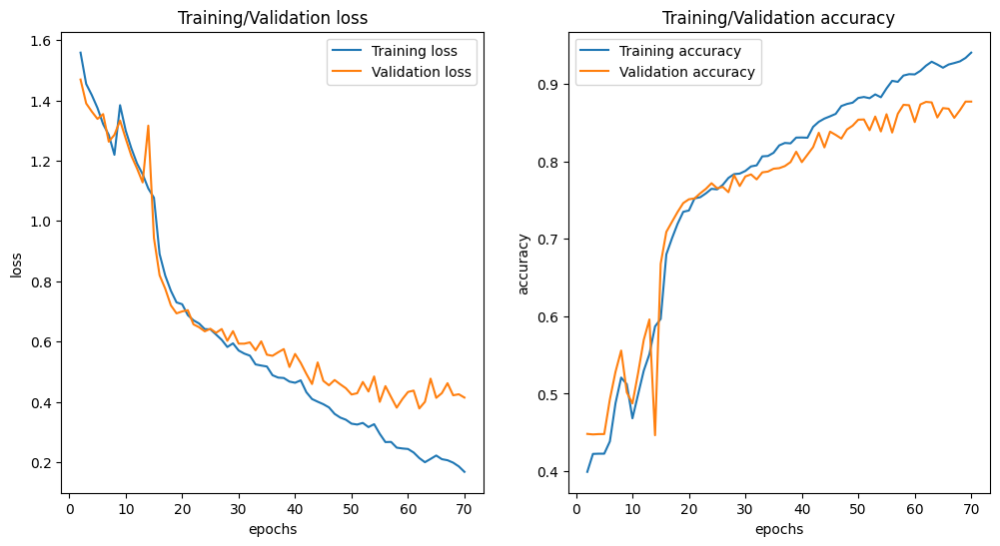

In [ ]:
# 결과 시각화

epochs = range(1, len(history.history["loss"]) + 1)[1:]
loss = history.history["loss"][1:]
val_loss = history.history["val_loss"][1:]
acc = history.history["accuracy"][1:]
val_acc = history.history["val_accuracy"][1:]

plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.plot(epochs, loss, label="Training loss")
plt.plot(epochs, val_loss, label="Validation loss")
plt.xlabel("epochs")
plt.ylabel("loss")
plt.title("Training/Validation loss")
plt.legend()

plt.subplot(1,2,2)
plt.plot(epochs, acc, label="Training accuracy")
plt.plot(epochs, val_acc, label="Validation accuracy")
plt.xlabel("epochs")
plt.ylabel("accuracy")
plt.title("Training/Validation accuracy")
plt.legend()

In [ ]:
from tensorflow.keras.models import load_model

model_path = 'segmentation.h5'

loaded_model = load_model(model_path)
loaded_model.evaluate(test_input_imgs, test_targets)

1/1 [==============================] - 1s 515ms/step - loss: 0.4386 - accuracy: 0.8757


[0.43859004974365234, 0.8756785988807678]

In [ ]:
prediction = loaded_model.predict(test_input_imgs)

1/1 [==============================] - 0s 240ms/step


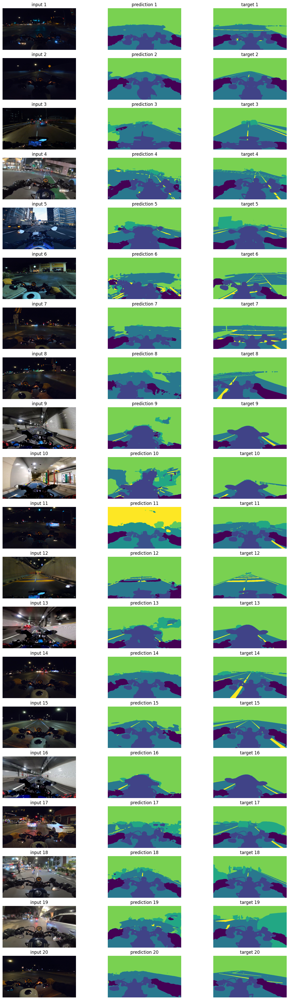

In [ ]:
# 모델의 예측 결과 시각화

def convert_output(pred):
    out = np.argmax(pred, axis=-1)
    return out

plt.figure(figsize=(15,50))

for i in range(20):
    plt.subplot(20,3,3*i+1)
    plt.axis('off')
    plt.imshow(test_input_imgs[i]/255)
    plt.title(f'input {i+1}')

    plt.subplot(20,3,3*i+2)
    plt.axis('off')
    output = prediction[i]
    output_img = convert_output(output)
    plt.imshow(output_img)
    plt.title(f'prediction {i+1}')

    plt.subplot(20,3,3*i+3)
    plt.axis('off')
    plt.imshow(test_targets[i])
    plt.title(f'target {i+1}')

In [ ]:
%load_ext tensorboard

%tensorboard --logdir './log'

# 아래 로그가 길어서 지원 안한다는
# %tensorboard dev upload \
#   --logdir './log' \
#   --name "MainQ2 Night_Ride_Image_segmentation" \
#   --one_shot

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 5459), started 0:14:47 ago. (Use '!kill 5459' to kill it.)

<IPython.core.display.Javascript object>